In [1]:
# Useful starting lines
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
%load_ext autoreload
%autoreload 2

## Load the training data into feature matrix, class labels, and event ids:

In [6]:
from proj1_helpers import *
DATA_TRAIN_PATH = '/Users/yao-chiehhu/Desktop/project1/données/train.csv' #download train data and supply path here 
y, tX, ids = load_csv_data(DATA_TRAIN_PATH)

## Data cleaning:

In [8]:
#Removing the rows where there is a -999 value for the selected features

def remove_rows_variable(tX):
    boo = [not((tX[i] == -999).any()) for i in range(tX.shape[0])]
    ind = np.where(boo)[0]
    return ind,tX[ind]

def remove_rows_all(tX,y):
    boo = [not((tX[i] == -999).any()) for i in range(tX.shape[0])]
    ind = np.where(boo)[0]
    return ind,tX[ind],y[ind]

In [9]:
#Take the features in a list
#Form the variables without the 999 values

variables = [tX[:,i] for i in range(tX.shape[1])]
index_without_999, tX_without_999, y_without_999 = remove_rows_all(tX,y)


In [10]:
variables_without_999 = np.asarray([remove_rows_variable(variables[i]) for i in range(30)])

In [11]:
#Outliers detection

#Method 1:
def outliers_without_999_values_eye(variables):
    for i in range(len(variables)):
        index_without_999_values, v_without_999_values , y_without_999_values = remove_rows_all(variables[i],y)
        plt.scatter(v_without_999_values,y_without_999_values)
        plt.xlabel('V'+str(i))
        plt.ylabel('y')
        plt.grid(True)
        plt.show()
    
v1_outlier_m1 = np.where(variables[1] > 500)[0] 
v3_outlier_m1 = np.where(variables[3] > 1500)[0] 
v8_outlier_m1 = np.where(variables[8] > 2500)[0] 
v13_outlier_m1 = np.where(variables[13] > 600)[0] 
v19_outlier_m1 = np.where(variables[19] > 800)[0] 
v23_outlier_m1 = np.where(variables[23] > 1000)[0]

#Method 2:

def outliers_boxplot(variables):
    for i in range(len(variables)):
        plt.boxplot(variables[i])
        plt.title('V'+str(i))
        plt.grid(True)
        plt.show()

def outliers_m2(variables):
    index_and_values = []
    for v in variables:
        ind , v_without_999 = remove_rows_variable(v)
        q75, q25 = np.percentile(v_without_999, [75 ,25])
        iqr = q75 - q25
        lb = q25 - 1.5*iqr
        ub = q75 + 1.5*iqr
        index_and_values_v = [[ind[i],v_without_999[i]] for i in range(v_without_999.shape[0]) \
                      if v_without_999[i] <= ub and v_without_999[i] >= lb]
        index_and_values.append(index_and_values_v)
    return index_and_values

index_and_values = outliers_m2(variables)

## Distribution and type of the features:

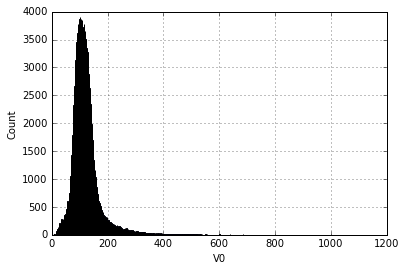

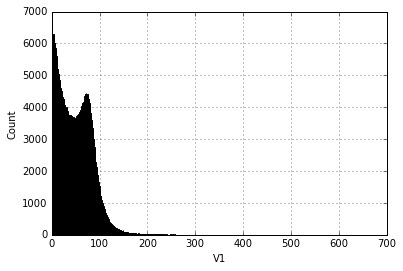

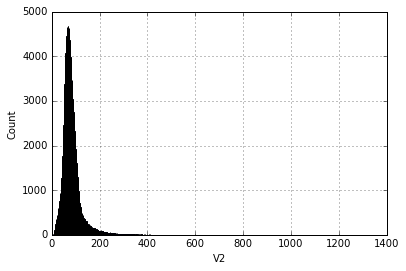

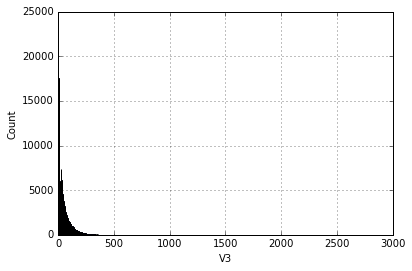

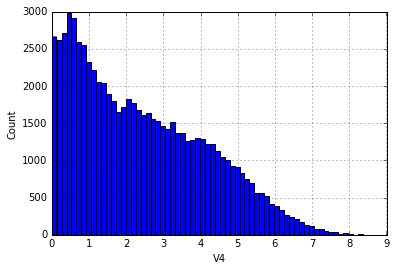

...

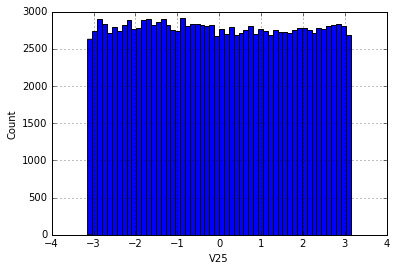

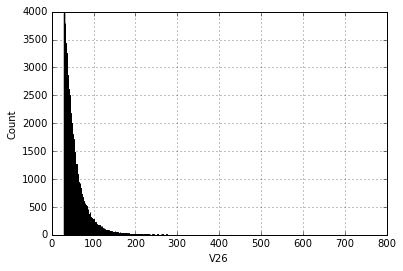

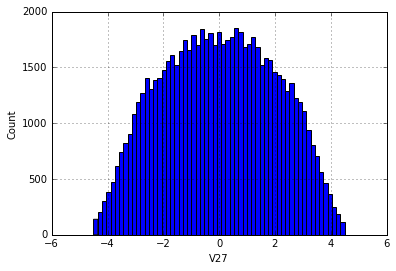

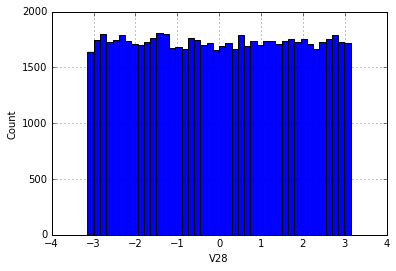

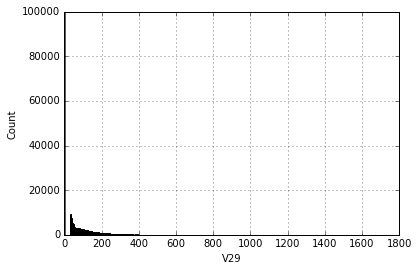

In [12]:
#Check the kind of variables with an histogram where we deleted the -999 values for each variable

#The variable number 22 is discrete with four possible values : 0,1,2 and 3
#The others are continuous

#Uniform distribution : V28,V25, V20, V15
#Gaussian distribution : V24, V6

for i in range(len(variables)):
    ind, v = remove_rows_variable(np.asarray(variables[i]))
    plt.hist(v,bins = 'auto')
    plt.xlabel('V'+str(i))
    plt.ylabel('Count')
    plt.grid(True)
    plt.show()


## Dependencies:

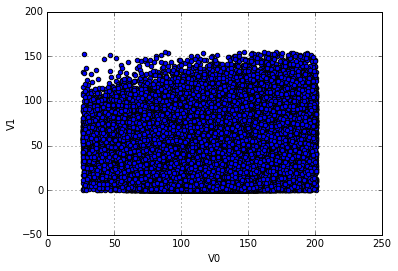

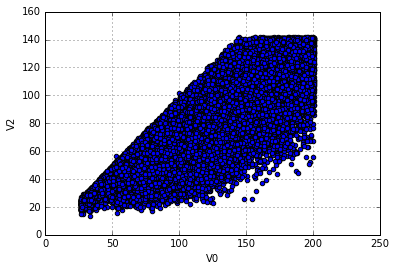

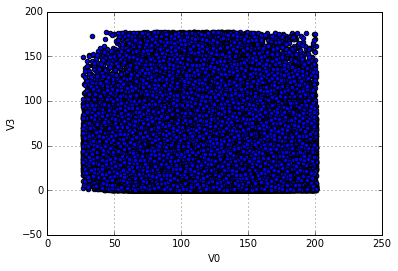

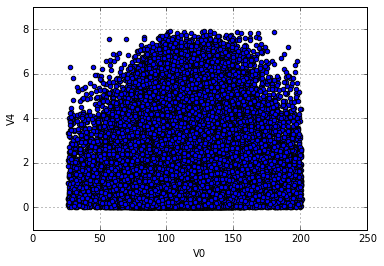

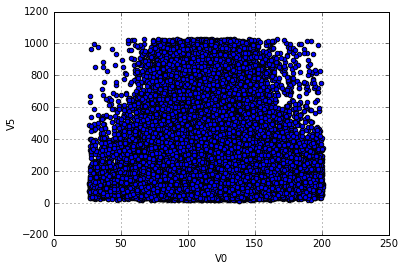

...

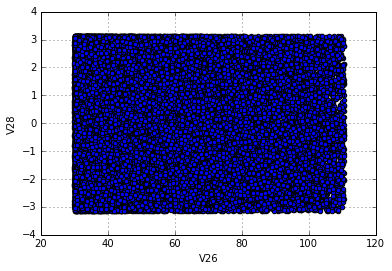

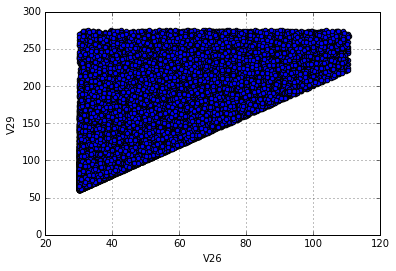

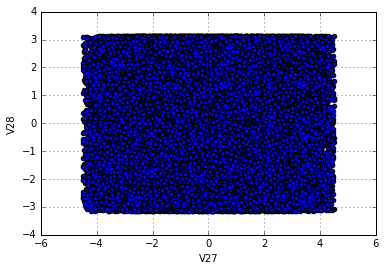

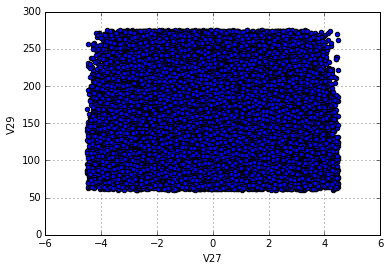

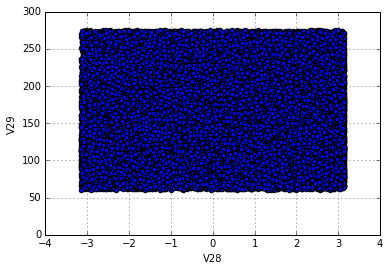

In [13]:
#Check the dependencies for each feature
def check_dependencies_between_one_and_all_variables(index_and_values0,index_and_valuesv,\
                                                     variable_number):
    index0 =  np.asarray(index_and_values0,dtype = 'int')[:,0]
    for i in range(variable_number + 1,30):
        index = np.asarray(index_and_values[i],dtype='int')[:,0]
        indices = np.intersect1d(index0,index)
        x1 = variables[variable_number][indices]
        x2 = variables[i][indices]
        plt.scatter(x1,x2)
        plt.xlabel('V'+str(variable_number))
        plt.ylabel('V'+str(i))
        plt.grid(True)
        plt.show()
    
for i in range(30):
    check_dependencies_between_one_and_all_variables(index_and_values[i],index_and_values[(i+1):30],i)
    
#The possible dependencies are :
#V0 with V2 
#V2 with V7
#V4 with V6
#V5 with V6
#V6 with V24 and V27
#V9 with V23 and V29
#V22 with V29
#V23 with V29




In [14]:
#Check the correlations

def correlation(index_and_values0,index_and_values1,i): 
    index0 = np.asarray(index_and_values0,dtype = 'int')[:,0]
    index1 = np.asarray(index_and_values1,dtype = 'int')[:,0]
    indices = np.intersect1d(index0,index1)
    x1 = variables[i[0]][indices]
    x2 = variables[i[1]][indices]
    return np.corrcoef(x1,x2)
    
list_of_variables = [[0,2],[2,7],[4,6],[5,6],[6,24],[6,27],[9,23],[9,29],[22,29],[23,29]]
c = []

for i in list_of_variables:
    c.append(correlation(index_and_values[i[0]],index_and_values[i[1]],i)[0][1])

#The dependencies with a treshold of 0.82 are :
#V0 with V2 : 0.827
#V4 with V6 : -0.824
#V9 with V29 : 0.946
#V22 with V29 : 0.876
#V23 with V29 : 0.824



## Dimension reduction:

In [15]:
#PCA implementation

def pca(tx):
    C = tx.T
    mu = np.mean(C,axis = 1)
    for i in range(C.shape[0]):
        C[i] = C[i] - np.asarray([[mu[i]]*C.shape[1]]) 
    R = (1/tx.shape[1])*np.dot(C,C.T)
    D,V = np.linalg.eig(R)
    Z = np.dot(V.T,C)
    ratio = np.sum(D[0:8])/np.sum(D)
    return D,V,ratio

D, V, ratio = pca(tX_without_999) #The first 8 variables represent 99,3% of the total variance


In [661]:
#0 with 86488
#4-5-6-12-26-27-28 with 402796
#23-24-25 with 227458

tX_without_999[:,0]

array([ 15.65381557, -33.07218443,  25.93781557, ...,   3.33481557,
         7.25881557,  94.20381557])

## Add the ones vector to the dataset:

In [606]:
#Add the one column

def add_ones(X):
    return np.append(np.ones((X.shape[0],1)),X,axis=1)


## Functions we have to implement:

In [10]:
#Linear regression using gradient descent

def compute_gradient(y, tx, w):
    """Compute the gradient."""
    e = y - np.dot(tx,w)
    return (-1/len(y))*np.dot(np.transpose(tx),e)

def least_squares_GD(y, tx, gamma, max_iters):
    """Gradient descent algorithm."""
    # Define parameters to store w and loss
    ws = [np.zeros([tx.shape[1],1])]
    losses = []
    w = ws[0]
    for n_iter in range(max_iters):
        # compute gradient and loss
        loss = compute_loss(y,tx,w)
        gradient = compute_gradient(y,tx,w)
        #update w by gradient
        w = w - gamma*gradient
        # store w and loss
        ws.append(np.copy(w))
        losses.append(loss)
    return losses, ws


array([  1.38470000e+02,   5.16550000e+01,   9.78270000e+01,
         2.79800000e+01,   9.10000000e-01,   1.24711000e+02,
         2.66600000e+00,   3.06400000e+00,   4.19280000e+01,
         1.97760000e+02,   1.58200000e+00,   1.39600000e+00,
         2.00000000e-01,   3.26380000e+01,   1.01700000e+00,
         3.81000000e-01,   5.16260000e+01,   2.27300000e+00,
        -2.41400000e+00,   1.68240000e+01,  -2.77000000e-01,
         2.58733000e+02,   2.00000000e+00,   6.74350000e+01,
         2.15000000e+00,   4.44000000e-01,   4.60620000e+01,
         1.24000000e+00,  -2.47500000e+00,   1.13497000e+02])

In [ ]:
#Linear regression using stochastic gradient descent

#Batch size for the SGD algorithm
def batch_size():
    B = 1
    return B

def compute_stoch_gradient(y, tx, w):
    #implement stochastic gradient computation fo batch data
    g = 0
    for i in range(len(y)):
        ei = y[i] - np.dot(tx[i],w)
        gradi = -np.dot(tx[i].T,ei)
        g = g + gradi
    return g


def least_squares_SGD(y, tx, gamma, max_iters):
    # returns mse, and weights
    batch_size = batch_size()
    w = initial_w
    ws = [initial_w]
    losses = []
    gen = batch_iter(y, tx, batch_size, shuffle=True)
    m = list(gen)
    for i in range(max_iters):
        minibatch_y,minibatch_tx = m[i]
        g = compute_stoch_gradient(minibatch_y,minibatch_tx,w)
        w = w - gamma*(1/len(minibatch_y))*g
        loss = compute_loss(y,tx,w)
        ws.append(np.copy(w))
        losses.append(loss)
    return losses, ws

In [613]:
#Least squares regression using normal equations

def least_squares(y, tx):
    # returns mse, and optimal weights
    w = np.dot(np.dot(np.linalg.inv(np.dot(tx.T,tx)),tx.T),y)
    e = y - np.dot(tx,w)
    return (1/(2*len(y)))*np.dot(e.T,e),w

In [16]:
#Ridge regression using normal equations

def ridge_regression(y, tx, lambda_):
    # Get the optimal weight(w*) by ridge regression
    ridge_w = np.linalg.solve(tx.T @ tx + lamb*np.eye(len(tx.T)), tx.T @ y)
    
    # Calculate the MSE loss with ridge_w
    e = y - tx @ ridge_w
    N = len(y)
    mse = (1/(2*N)) * e.T @ e
    
    return mse, ridge_w

In [ ]:
#Logistic regression using gradient descent or SGD

def logistic_regression(y, tx, gamma, max_iters):

In [ ]:
#Regularized logistic regression using gradient descent or SGD

def reg_logistic_regression(y, tx, lambda , gamma, max_iters):

# First method by deleting the -999 values and fitting several regressions:

## Features extraction for the linear regression:

In [695]:
#Selecting the right features

#reg1 : without 0-4-5-6-12-23-24-25-26-27-28
#reg2 : with everything
#reg3 : without 0
#reg4 : without 4-5-6-12-23-24-25-26-27-28

def linear_regression(columns_to_delete):
    tx_1 = np.delete(tX,columns_to_delete,axis = 1)
    v_1 = [tx_1[:,i] for i in range(tx_1.shape[1])]
    index_and_values_1 = outliers_m2(v_1)
    index_1 = [np.asarray(index_and_values_1[i],dtype = 'int')[:,0] for i in range(len(v_1))]
    final_index_1 = index_1[0]
    for i in range(1,len(v_1)):
        final_index_1 = np.intersect1d(final_index_1,index_1[i])
    tx_1 = add_ones(np.asarray([v_1[i][final_index_1] for i in range(len(v_1))]).T)
    y_1 = y[final_index_1]
    mse_1,w_1 = least_squares(y_1,tx_1)
    return y_1,tx_1,mse_1,w_1
    

In [702]:
reg_1 = linear_regression([0,4,5,6,12,23,24,25,26,27,28])
reg_2 = linear_regression([])
reg_3 = linear_regression([0])
reg_4 = linear_regression([4,5,6,12,23,24,25,26,27,28])

In [729]:
print(reg_1[2],reg_2[2],reg_3[2],reg_4[2])

0.323670737878 0.342055779709 0.346096531625 0.358852601099


In [595]:
#Trying with all the features

indexs = [np.asarray(index_and_values[i],dtype = 'int')[:,0] for i in range(30)]
final_index = indexs[0]
for i in range(1,30):
    final_index = np.intersect1d(final_index,indexs[i])


In [621]:
#Form the dataset

tX_test = add_ones(np.asarray([variables[i][final_index] for i in range(30)]).T)
y_test = y[final_index]


In [622]:
#Make the linear regression

mse_training, weights = least_squares(y1,tx1)


## Generate predictions and save ouput in csv format for submission:

In [704]:
DATA_TEST_PATH = '/Users/zaimwadghiri/Desktop/PCML/ML_course-master3/projects/project1/données/test.csv' # TODO: download train data and supply path here 
_, tX_test, ids_test = load_csv_data(DATA_TEST_PATH)

In [715]:
ind_999 = [np.where(tX_test[:,i] == -999)[0] for i in [0,4,23]]
ind_without_999 = [np.where(tX_test[:,i] != -999)[0] for i in [0,4,23]]

In [720]:
ind_reg_1 = ind_999[0]
for i in range(1,3):
    ind_reg_1 = np.intersect1d(ind_reg_1,ind_999[i])
tX_reg_1 = (add_ones(np.delete(tX_test,[0,4,5,6,12,23,24,25,26,27,28],axis = 1)))[ind_reg_1]
y_reg_1 = np.dot(tX_reg_1,reg_1[3])

In [722]:
ind_reg_2 = ind_without_999[0]
for i in range(1,3):
    ind_reg_2 = np.intersect1d(ind_reg_2,ind_without_999[i])
tX_reg_2 = (add_ones(np.delete(tX_test,[],axis = 1)))[ind_reg_2]
y_reg_2 = np.dot(tX_reg_2,reg_2[3])

In [724]:
ind_reg_3 = ind_999[0]
for i in range(1,3):
    ind_reg_3 = np.intersect1d(ind_reg_3,ind_without_999[i])
tX_reg_3 = (add_ones(np.delete(tX_test,[0],axis = 1)))[ind_reg_3]
y_reg_3 = np.dot(tX_reg_3,reg_3[3])

In [730]:
ind_reg_4 = ind_without_999[0]
for i in range(1,3):
    ind_reg_4 = np.intersect1d(ind_reg_4,ind_999[i])
tX_reg_4 = (add_ones(np.delete(tX_test,[4,5,6,12,23,24,25,26,27,28],axis = 1)))[ind_reg_4]
y_reg_4 = np.dot(tX_reg_4,reg_4[3])

(168195,)

In [735]:
#y_reg_4.shape[0] + y_reg_3.shape[0] + y_reg_2.shape[0] + y_reg_1.shape[0]
tX_test.shape

(568238, 30)

In [659]:
#0 with 86488
#4-5-6-12-26-27-28 with 402796
#23-24-25 with 227458

index_0_4 = np.intersect1d(whr[0],whr[27]) #76506 nan between 0 and 4-5-6-26-27-28
index_0_23 = np.intersect1d(whr[0],whr[23]) #59263 nan between 0 and 23-24-25
index_4_23 = np.intersect1d(whr[4],whr[23]) #227458 nan between 4 and 23
index_0_4_23 = np.intersect1d(whr[0],index_4_23) #same as index_0_23

#Lignes ou il y a des nan de 4 et 23 mais pas dans 0 : on garde que 0 = 343533 avec nan
#Lignes ou il y a des nan de 4 et 23 et 0 : on garde rien = 59263 avec nan
#Lignes ou il y a des nan de 0 mais pas dans 4 et 23 : on garde 4 et 23 = 9982 avec nan
#Lignes ou il y a pas de nan : on garde tout = 155460 sans nan

#Essayer d'enlever 0 vu la correlation avec 2 
#Essayer de ne pas enlever 0

59263

In [624]:
OUTPUT_PATH = '/Users/zaimwadghiri/Desktop/sub.csv' # TODO: fill in desired name of output file for submission
y_pred = predict_labels(weights, tX_test)
create_csv_submission(ids_test, y_pred, OUTPUT_PATH)

ValueError: shapes (568238,30) and (31,) not aligned: 30 (dim 1) != 31 (dim 0)